# Loan Portfolio Data Cleaning and Transformation

In this notebook, we will focus on cleaning and transforming the loan portfolio data.
We will ensure that all columns are in the correct format, convert certain columns to categorical types, and handle missing values.
This is a critical step before proceeding with exploratory data analysis (EDA) and querying the data.

The steps we'll follow:
1. Load the dataset.
2. Apply necessary transformations (convert dates, clean columns, handle missing values).
3. Prepare the data for further analysis.

## Step 1: Load the Dataset

We'll begin by loading the loan portfolio dataset into a Pandas DataFrame to inspect the data structure.


### Importing Required Libraries
- **Pandas**: Used for data manipulation and analysis, particularly for structured datasets.
- **Numpy**: Provides support for mathematical operations on arrays.
- **Matplotlib**, **Seaborn** and **Plotly**: Libraries used for data visualisation, helpful in understanding data trends.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import logging
import missingno as msno

from b_class_data_transform import DataTransform
from b_class_data_frame_info import DataFrameInfo
from b_class_data_frame_transform import DataFrameTransform
from b_class_plotter import Plotter

# Load the dataset from the CSV file
df = pd.read_csv('b_df_1_loan_payments.csv')

## Step 2: Inspect the Dataset

We will inspect the columns and data types to identify which columns need to be transformed. In this step, we are loading the dataset into a Pandas DataFrame. 
This allows us to easily manipulate, transform, and analyze our data.

### Dataset Overview
We will start by inspecting the dataset using functions like `.head()`, `.info()`, and `.describe()`. This helps us understand the basic structure, data types, and key statistical features of the dataset.

In [2]:
# Display basic information about the dataset, including column names and data types

df.info(), df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54231 entries, 0 to 54230
Data columns (total 43 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   id                           54231 non-null  int64  
 1   member_id                    54231 non-null  int64  
 2   loan_amount                  54231 non-null  int64  
 3   funded_amount                51224 non-null  float64
 4   funded_amount_inv            54231 non-null  float64
 5   term                         49459 non-null  object 
 6   int_rate                     49062 non-null  float64
 7   instalment                   54231 non-null  float64
 8   grade                        54231 non-null  object 
 9   sub_grade                    54231 non-null  object 
 10  employment_length            52113 non-null  object 
 11  home_ownership               54231 non-null  object 
 12  annual_inc                   54231 non-null  float64
 13  verification_sta

(None,
          id  member_id  loan_amount  funded_amount  funded_amount_inv  \
 0  38676116   41461848         8000         8000.0             8000.0   
 1  38656203   41440010        13200        13200.0            13200.0   
 2  38656154   41439961        16000        16000.0            16000.0   
 3  38656128   41439934        15000        15000.0            15000.0   
 4  38656121   41439927        15000        15000.0            15000.0   
 
         term  int_rate  instalment grade sub_grade  ... recoveries  \
 0  36 months      7.49      248.82     A        A4  ...        0.0   
 1  36 months      6.99      407.52     A        A3  ...        0.0   
 2  36 months      7.49      497.63     A        A4  ...        0.0   
 3  36 months     14.31      514.93     C        C4  ...        0.0   
 4  36 months      6.03      456.54     A        A1  ...        0.0   
 
   collection_recovery_fee  last_payment_date last_payment_amount  \
 0                     0.0           Jan-2022     

### The <b>dataset consists of 54,231 entries and 43 columns</b>, including both numerical and categorical types. <br><br>Here’s an overview of the columns to help with transformations:


1. Date Columns (object type): Columns like `issue_date`, `earliest_credit_line`, `last_payment_date`, `next_payment_date`, and `last_credit_pull_date` are stored as strings but should be converted to datetime format.

2. Numeric Columns (float/int type): Fields such as `loan_amount`, `int_rate`, `instalment`, `total_payment`, etc., are numerical but may require handling for missing values or reformatting, especially if some percentages are represented inconsistently.

3. Categorical Columns (object type): Columns like `term`, `grade`, `sub_grade`, `home_ownership`, `verification_status`, `loan_status`, `application_type` contain discrete categories and could be set as categorical types for more efficient analysis.

4. Symbolic Cleaning: The `term` column, with values like "36 months," could be cleaned by removing "months" to convert it to a numerical format.

5. **Missing Values**: Several columns show missing values, notably `funded_amount`, `int_rate`, `employment_length`, `mths_since_last_delinq`, and `mths_since_last_record`. These will need further investigation for either imputation or removal.
   
   - **Types of Missing Values**:
     - MCAR (Missing Completely at Random)
     - MAR (Missing at Random)
     - MNAR (Missing Not at Random)
   - **Handling Strategies**:
     - Imputation: Filling missing values with statistical measures (mean, median, mode)
     - Deletion: Removing rows with missing values when appropriate
     - Special value: Using a special category for missing values in categorical data

# Missing Data Analysis Insights

<Axes: >

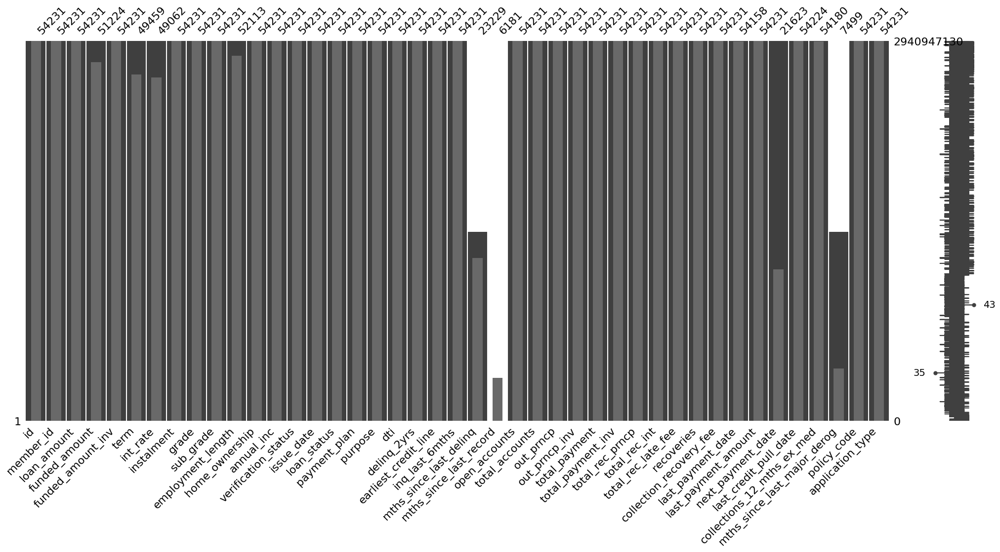

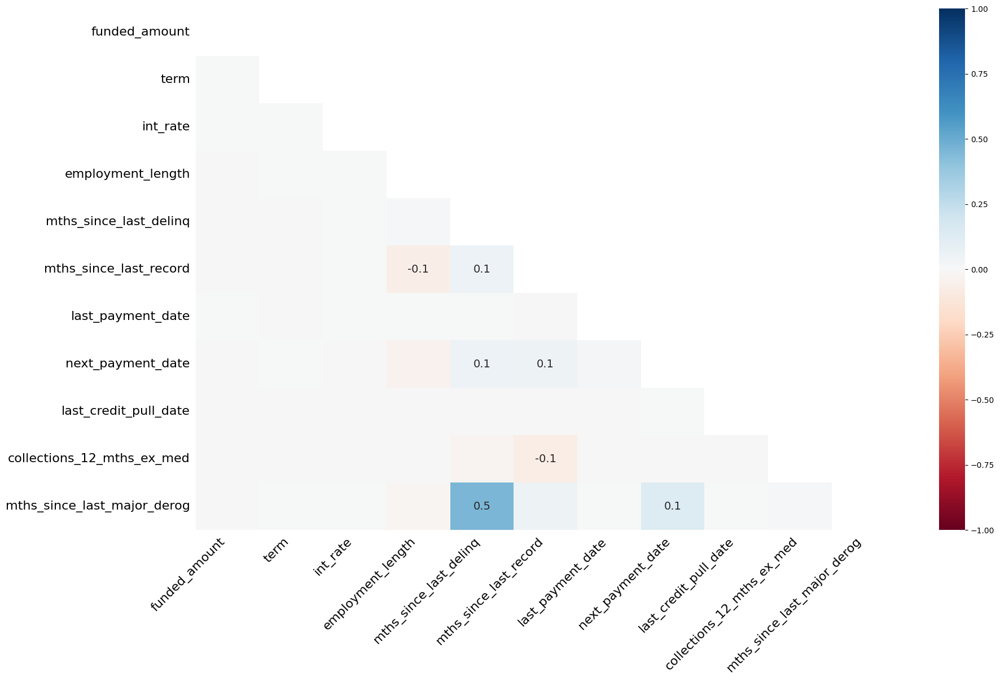

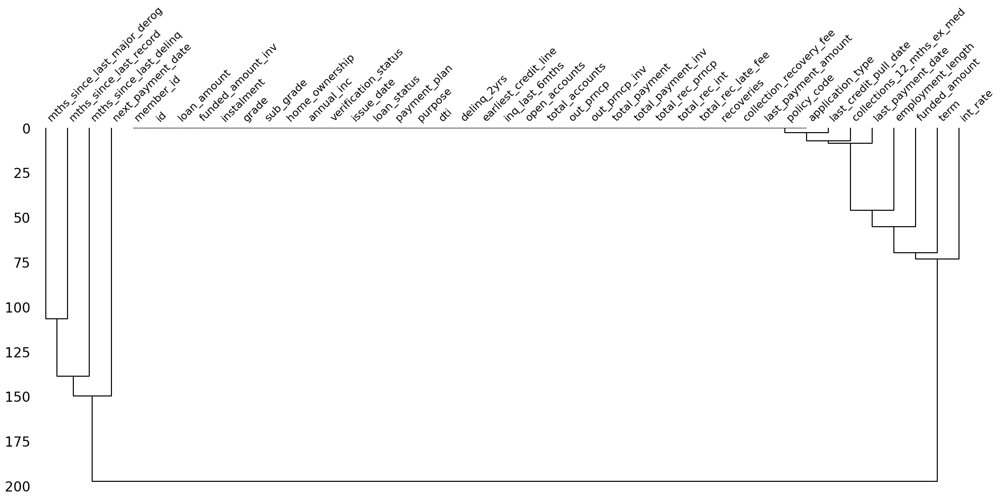

In [3]:
# Matrix visualization to show the nullity of the DataFrame
msno.matrix(df)

# Use a bar plot instead
msno.bar(df)

# Or a heatmap to show correlations of missingness
msno.heatmap(df)

# Visualize the dendrogram of missing data to identify clusters of missingness
msno.dendrogram(df)

## Bar Plot of Missing Data
The bar plot visualization shows the counts of non-null values for each column:

- **Columns with Complete Data**:
  - Many columns, such as `id`, `loan_amount`, and `funded_amount`, have complete data without any missing values, showing a full bar with the maximum count of 54,231 entries.
  
- **Columns with Missing Data**:
  - Columns such as `mths_since_last_delinq`, `next_payment_date`, and `mths_since_last_record` have a substantial number of missing values.
    - `mths_since_last_record` appears to have significantly fewer non-null values compared to others, which may affect its reliability in analysis.
  
- **Actions to Consider**:
  - For columns with significant missing values, imputation techniques could be applied, or columns may be removed if they are deemed unnecessary for the analysis.
  - It is important to evaluate if the missingness affects the quality or bias in our analysis, especially for highly incomplete columns.
<br><br>
## Heatmap of Missing Data Correlations
The heatmap visualizes correlations between missing values across different columns:

- **Correlation of Missingness**:
  - There is a moderate positive correlation between `mths_since_last_record` and `mths_since_last_major_derog`, suggesting that these two columns tend to be missing together. This correlation may be meaningful, and joint imputation strategies could be considered for these columns.
  - A slight positive correlation between `last_payment_date` and `next_payment_date` indicates a relationship between borrowers missing both recent and future payment dates.

- **Negative and Low Correlations**:
  - A slight negative correlation between `mths_since_last_record` and other columns like `collections_12_mths_ex_med` suggests that missingness is mostly independent across the dataset, aside from a few pairs.
  - Low correlations indicate that many columns are missing values independently, which suggests that individual imputation could be effective for those columns.

- **Actions to Consider**:
  - For highly correlated missing columns, a joint imputation strategy may help maintain consistency.
  - Columns with sporadic missing values can be imputed using statistical measures such as mean, median, or mode.

### Summary
- Columns with high completeness are ready for analysis, while columns with missing data need further attention.
- The correlations between missing values can inform whether joint or individual imputation is appropriate, depending on the relationship between columns.
- Overall, understanding the patterns of missing data will guide the data preprocessing steps, helping to maintain data quality and reduce potential biases during analysis.
<br><br>
## Dendrogram Analysis of Missing Data

The dendrogram above visualizes the relationships between columns based on the similarity of their missing value patterns. It helps in understanding which columns tend to be missing together and can guide us in determining suitable strategies for handling missing data.

### Key Observations:

1. **Clusters of Columns with Similar Missing Patterns**:
   - The dendrogram indicates that certain columns tend to cluster together based on their missing value patterns. For example:
     - Columns like `mths_since_last_major_derog`, `mths_since_last_record`, `mths_since_last_delinq`, and `next_payment_date` form a distinct cluster. This suggests that these columns tend to have missing values in similar observations, implying a potential relationship between them.
   - Another cluster is formed by columns like `last_payment_date`, `collections_12_mths_ex_med`, and `last_credit_pull_date`. These columns may need special attention since missing data might be related across these features.

2. **Implications for Data Imputation**:
   - **Joint Imputation for Related Columns**: Columns that cluster together could be imputed jointly or using similar strategies since they share a common missingness pattern. For instance, the columns related to past delinquency and payment history (`mths_since_last_delinq`, `mths_since_last_record`) could be imputed together to maintain consistency.
   - **Independent Imputation**: Columns that are far from each other in the dendrogram likely have more independent missing value patterns. These columns can be handled individually, which may allow for simpler imputation strategies such as filling missing values with the median or mode.

3. **Patterns in Data Collection**:
   - The clustering of certain columns might indicate that the data collection process for these features is linked. For example, columns related to delinquency and payment might be missing because those values are not applicable or were not collected for specific individuals. Understanding this pattern could help guide both the data cleaning process and the analysis stage.

### Summary:
- The dendrogram provides valuable insight into the relationships between columns with missing data, which can help determine the most effective imputation or cleaning strategies.
- Columns that are closely clustered should be handled with special care, potentially using advanced methods like multivariate imputation to ensure consistency.
- This understanding also allows us to more accurately determine which columns are likely to add significant value to our models and analysis versus those that could be safely removed due to extensive missingness and low correlation with other data.

## Step 3: Data Cleaning and Transformation

We have identified that certain columns in the dataset are not in the correct format:
- Date columns need to be converted to a `datetime` format.
- The `term` column needs to be cleaned by removing unnecessary text and converting to a numerical format.
- Columns like `grade`, `sub_grade`, `home_ownership`, and `loan_status` should be converted to categorical data types.
- We will handle missing values in relevant columns.

We will now import and apply a `DataTransform` class that handles these transformations.

## Step 4: Apply Data Transformations

We'll now use the `DataTransform` class to:
- Convert date columns (`issue_date`, `last_payment_date`, etc.) to a `datetime` format.
- Clean the `term` column to retain only the numeric value.
- Convert relevant columns to categorical data types.
- Handle missing values in the appropriate columns.


In [4]:
# Instantiate the class for data transformations
transformer = DataTransform(df)

# Step 1: Convert date columns
date_columns = ['issue_date', 'earliest_credit_line', 'last_payment_date', 'next_payment_date', 'last_credit_pull_date']
transformer.convert_to_datetime(date_columns)

# Step 2: Convert the specified columns to int64
int_columns = [
    'id', 'member_id', 'delinq_2yrs', 'inq_last_6mths',
    'mths_since_last_delinq', 'mths_since_last_record', 'open_accounts',
    'total_accounts', 'collections_12_mths_ex_med', 'mths_since_last_major_derog', 'policy_code'
]
transformer.convert_to_int64(int_columns)

# Step 3: Convert term to numerical by removing "months"
transformer.convert_to_numerical('term', remove_text=" months")

# Step 4: Convert employment_length to numerical
transformer.convert_employment_length('employment_length')

# Step 5: Set categorical columns
categorical_columns = ['grade', 'sub_grade', 'home_ownership', 'verification_status', 'loan_status', 'application_type', 'payment_plan', 'purpose']
transformer.set_categorical(categorical_columns)

# Step 6: Summarize transformations to confirm changes
transformer.summarize_transforms()

# Get summary statistics
statistics = transformer.summary_statistics()
logging.info(f"Summary statistics: {statistics}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54231 entries, 0 to 54230
Data columns (total 43 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   id                           54231 non-null  int64         
 1   member_id                    54231 non-null  int64         
 2   loan_amount                  54231 non-null  int64         
 3   funded_amount                51224 non-null  float64       
 4   funded_amount_inv            54231 non-null  float64       
 5   term                         49459 non-null  float64       
 6   int_rate                     49062 non-null  float64       
 7   instalment                   54231 non-null  float64       
 8   grade                        54231 non-null  category      
 9   sub_grade                    54231 non-null  category      
 10  employment_length            52113 non-null  float64       
 11  home_ownership               54231 non-nu

### The transformations have been successfully applied, resulting in the following updates:

- <b>Datetime Conversion:</b> Date columns (`issue_date`, `earliest_credit_line`, `last_payment_date`, `next_payment_date`, and `last_credit_pull_date`) were converted to `datetime64` format.
  
- <b>Numeric Conversion:</b> The `term` column was transformed to numerical format by removing the "months" text and casting it to `float`.
  
- <b>Categorical Type Conversion:</b> Columns such as `grade`, `sub_grade`, `home_ownership`, `verification_status`, `loan_status`, and `application_type` were converted to categorical types, reducing memory usage and optimizing storage.


## **Step 6: `DataFrameInfo` Class for Extracting Information**

We will now use a custom `DataFrameInfo` class that will help us extract various useful information about our DataFrame (df).

### Data Quality Assessment
Using the DataFrameInfo class, we can:
- Track missing values
- Analyze data distributions
- Identify potential data quality issues

### Visualisation and Interpretation
The transformed data enables:
- Time series analysis of loan issuance
- Category-based grouping and aggregation
- Statistical analysis of numerical features

### Results and Impact
- Cleaned dataset ready for analysis
- Properly formatted dates for temporal analysis
- Optimized memory usage through proper data typing
- Consistent numerical formats for calculations

### Next Steps
1. Feature engineering based on cleaned data
2. Statistical analysis of loan characteristics
3. Visualization of key metrics and trends

#### **Methods**

- *describe_columns*: Provides a summary of each column’s data type and counts for non-null values.
- *get_statistics*: Extracts key statistics (mean, median, standard deviation) for numerical columns.
- *count_distinct_values*: Counts unique values in categorical columns.
- *get_shape*: Returns the shape (rows, columns) of the DataFrame.
- *count_nulls*: Computes the count and percentage of null values for each column.
- *summarize_info*: Summarizes all insights in one output for quick reference.



In [5]:
# Instantiate and summarize data using DataFrameInfo
df_info = DataFrameInfo(df)

# Generate initial null summary specifically
initial_null_summary = df_info.count_nulls().reset_index()  # Save for future plotting if needed

# Optionally, get other summarized information if needed
summary_info = df_info.summarize_info()

# Display summary information if needed
print("\nStatistics:\n", summary_info['statistics'].applymap(lambda x: f"{x:,.2f}"))
print("\nDistinct Values in Categorical Columns:\n", summary_info['distinct_counts'])
print("\nNULL Values Summary:\n", summary_info['null_summary'])
print("\nShape of the DataFrame:\n", summary_info['shape'])

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54231 entries, 0 to 54230
Data columns (total 43 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   id                           54231 non-null  int64         
 1   member_id                    54231 non-null  int64         
 2   loan_amount                  54231 non-null  int64         
 3   funded_amount                51224 non-null  float64       
 4   funded_amount_inv            54231 non-null  float64       
 5   term                         49459 non-null  float64       
 6   int_rate                     49062 non-null  float64       
 7   instalment                   54231 non-null  float64       
 8   grade                        54231 non-null  category      
 9   sub_grade                    54231 non-null  category      
 10  employment_length            52113 non-null  float64       
 11  home_ownership               54231 non-nu

## **Step 7: `DataFrameTransform` Class for transforming the data**

To handle missing values effectively, I’ll design the `DataFrameTransform` class to include methods for identifying and handling missing data.

#### **Methods**

- *check_nulls*: Displays null counts and percentages for columns, helping to decide on handling strategies.
- *drop_columns*: Drops columns with missing data above a given threshold.
- *impute_missing_values*: Imputes missing values in columns based on their data type or a specified method (e.g., mean or median).
- *confirm_no_nulls*: Verifies that all nulls have been handled by re-checking and summarizing remaining nulls.



In [6]:
# Instantiate and apply transformations using DataFrameTransform
df_transform = DataFrameTransform(df)

# 1. Drop Columns with >50% Missing Data
df_transform.drop_columns(threshold=50.0)

# 2. Impute Missing Values (default: mean for numerical, mode for categorical)
df_transform.impute_missing_values(method='mean')

# 3. Confirm No Remaining Nulls (optional final check)
final_null_check = df_transform.confirm_no_nulls()


Dropped columns with more than 50.0% missing data: ['next_payment_date']

Imputed missing values using the mean method for numerical and mode for categorical columns.

Total remaining NULL values in DataFrame: 80
There are still NULL values in the DataFrame.


### The missing data handling steps have been applied with the following results:

1. <b>Initial Null Check:</b> Identified columns with substantial missing data, including columns with over 50% missing values.

2. <b>Column Dropping:</b> Removed columns with more than 50% missing data: `mths_since_last_delinq`, `mths_since_last_record`, `next_payment_date`, and `mths_since_last_major_derog`.

3. <b>Imputation:</b> Imputed remaining missing values, using the mean for numerical columns and the mode for categorical columns.

### Outcome:

- <b>Remaining Nulls:</b> Only 80 nulls remain in the dataset, primarily in minor columns. We can either further analyze these columns or proceed with visualization using the Plotter class.

## **Step 8: `Plotter` Class for Interactive Charts**

To visualise the transformations and null value distributions effectively, I am designing a `Plotter` class using Plotly for interactive charts. 

The `Plotter` class is designed to handle data visualizations using Plotly, focusing on:

- **Null Distribution:** Visualize missing data before and after handling.
- **Numerical Distributions:** Plot histograms for each numerical column.
- **Categorical Counts:** Display bar charts for unique value counts in each categorical column.

#### **Methods**

1. `plot_null_distribution(self, initial_nulls, final_nulls):` <br>
   Displays the count of null values per column before and after transformations. It also creates a grouped bar chart with Plotly’s `graph_objects` to compare initial and final null counts.
   <br><br>
2. `plot_numerical_distributions(self):`<br>
   Plots histograms for numerical columns to understand data distributions.Iterates over all numerical columns, using px.histogram to display distributions.
   <br><br>
3. `plot_categorical_counts(self):` <br>Show counts of each unique value in categorical columns. For each categorical column, generates a bar chart showing unique value counts using `px.bar`.



In [7]:
# Step-by-Step Application with Plotting Code

# IMPORTANT: Update the DataFrame used in Plotter with the transformed DataFrame
# 1. Capture Final Null Summary for Plotting
final_null_summary = df_transform.check_nulls().reset_index()

# 2. Initialize Plotter with the transformed DataFrame
plotter = Plotter(df_transform.df)  # Use the transformed dataframe here, NOT the original `df`

# 3. Generate visualisations to compare before and after null handling
plotter.plot_null_distribution(initial_nulls=initial_null_summary, final_nulls=final_null_summary)
plotter.plot_numerical_distributions()
plotter.plot_categorical_counts()

NULL Values Summary:
                              Null Count  Percentage
id                                    0    0.000000
member_id                             0    0.000000
loan_amount                           0    0.000000
funded_amount                         0    0.000000
funded_amount_inv                     0    0.000000
term                                  0    0.000000
int_rate                              0    0.000000
instalment                            0    0.000000
grade                                 0    0.000000
sub_grade                             0    0.000000
employment_length                     0    0.000000
home_ownership                        0    0.000000
annual_inc                            0    0.000000
verification_status                   0    0.000000
issue_date                            0    0.000000
loan_status                           0    0.000000
payment_plan                          0    0.000000
purpose                               0   

### Outcomes 

1. Data Completeness:<br>
  Visual confirmation of null value reduction from `plot_null_distribution` helps ensure that missing data is handled effectively.<br><br>
1. Numerical Data Insights:<br>
  Histograms for each numerical column from `plot_numerical_distributions` offer insights into data distribution, skewness, and potential outliers.<br><br>
1. Categorical Data Insights:<br>
  Bar charts from `plot_categorical_counts` display the spread of unique values in categorical columns, aiding in understanding data diversity.

In [8]:
# Assuming previous steps are complete and `df` is the final cleaned DataFrame

# Step 5: Save a cleaned copy of the DataFrame for further analysis
df.to_csv("b_df_2_loan_data_cleaned.csv", index=False)
print("The cleaned DataFrame has been saved as 'b_df_2_loan_data_cleaned.csv'")

The cleaned DataFrame has been saved as 'b_df_2_loan_data_cleaned.csv'


# Explanation of Label Encoding and One-Hot Encoding

We transformed several categorical columns in our dataset into numerical form using both **Label Encoding** and **One-Hot Encoding**. Below is a detailed explanation of each step, and how specific values were assigned during these transformations.

## 1. Label Encoding for Multiple Columns

**Label Encoding** converts each unique category in the columns into numerical values that maintain the original ordering.

### a. `grade` Column
The `grade` column originally had categories such as **A**, **B**, **C**, etc., which represent different levels of creditworthiness. Here’s how they were converted:

- **A** -> 0
- **B** -> 1
- **C** -> 2
- **D** -> 3
- **E** -> 4
- **F** -> 5
- **G** -> 6

The numeric value for each grade indicates increasing risk, from **A** (lowest risk) to **G** (highest risk).

### b. `sub_grade` Column
The `sub_grade` column provides a finer granularity of the credit grade, such as **A1**, **A2**, **A3**, etc. These were also encoded with numeric values to represent their ordering:

- **A1** -> 0
- **A2** -> 1
- **A3** -> 2
- **A4** -> 3
- **A5** -> 4
- **B1** -> 5
- **B2** -> 6
- **B3** -> 7
- **B4** -> 8
- **B5** -> 9
- **C1** -> 10
- **C2** -> 11
- **C3** -> 12
- **C4** -> 13
- **C5** -> 14
- **D1** -> 15
- **D2** -> 16
- **D3** -> 17
- **D4** -> 18
- **D5** -> 19
- **E1** -> 20
- **E2** -> 21
- **E3** -> 22
- **E4** -> 23
- **E5** -> 24
- **F1** -> 25
- **F2** -> 26
- **F3** -> 27
- **F4** -> 28
- **F5** -> 29
- **G1** -> 30
- **G2** -> 31
- **G3** -> 32
- **G4** -> 33
- **G5** -> 34

For instance, **A1** is ranked higher than **A2**, which corresponds to a better credit standing. The encoding ensures that higher numerical values represent higher risk or lower creditworthiness.

### c. Additional Label Encoded Columns
Other categorical columns were also transformed using **Label Encoding**:

- **home_ownership**: {'MORTGAGE': 0, 'NONE': 1, 'OTHER': 2, 'OWN': 3, 'RENT': 4}
- **verification_status**: {'Not Verified': 0, 'Source Verified': 1, 'Verified': 2}
- **loan_status**: {'Charged Off': 0, 'Current': 1, 'Default': 2, 'Does not meet the credit policy. Status:Charged Off': 3, 'Does not meet the credit policy. Status:Fully Paid': 4, 'Fully Paid': 5, 'In Grace Period': 6, 'Late (16-30 days)': 7, 'Late (31-120 days)': 8}
- **purpose**: {'car': 0, 'credit_card': 1, 'debt_consolidation': 2, 'educational': 3, 'home_improvement': 4, 'house': 5, 'major_purchase': 6, 'medical': 7, 'moving': 8, 'other': 9, 'renewable_energy': 10, 'small_business': 11, 'vacation': 12, 'wedding': 13}

These columns were label encoded to maintain the original ordering or simplify categorical values.

## 2. One-Hot Encoding for Nominal Categorical Columns

**One-Hot Encoding** creates binary columns for each category, with a value of `1` indicating that the row belongs to that category and `0` otherwise.

The columns we used for **One-Hot Encoding** are:

- `payment_plan`

### One-Hot Encoding Transformations

#### a. `payment_plan`
This could indicate if there is a payment plan in place (**Yes** or **No**). After encoding, we ended up with a column:

- `payment_plan_y` -> `1` for Yes, `0` for No.

## Summary
- **Label Encoding** was used for **ordinal categorical columns** (`grade`, `sub_grade`) and other nominal columns (`home_ownership`, `verification_status`, `loan_status`, `purpose`) to convert them into numerical values while preserving the relationships or simplifying the categories.
- **One-Hot Encoding** was used for **nominal categorical columns** (`payment_plan`) to ensure no unintended ordinal relationships were introduced.

These transformations allow the model to understand and work with the categorical features effectively, avoiding issues that could arise if the categorical values were left in their original non-numeric forms.



In [9]:
# Load the data
df = pd.read_csv('b_df_2_loan_data_cleaned.csv')

In [10]:
# Instantiate the DataFrameTransform class with the DataFrame
df_transformer = DataFrameTransform(df)

# Apply the transformations using the DataFrameTransform instance
df_transformed = df_transformer.transform_dataframe()

# Display the transformed DataFrame
print("\nTransformed DataFrame:\n")
print(df_transformed.head())

# Retrieve and display the label encodings for reference
label_mappings = df_transformer.get_label_mappings()
print("\nLabel Encoding Mappings:")
for col, mapping in label_mappings.items():
    print(f"{col}: {mapping}")

One-Hot Encoding applied to column 'payment_plan', new columns added: ['payment_plan_y']

Transformed DataFrame:

         id  member_id  loan_amount  funded_amount  funded_amount_inv  term  \
0  38676116   41461848         8000         8000.0             8000.0  36.0   
1  38656203   41440010        13200        13200.0            13200.0  36.0   
2  38656154   41439961        16000        16000.0            16000.0  36.0   
3  38656128   41439934        15000        15000.0            15000.0  36.0   
4  38656121   41439927        15000        15000.0            15000.0  36.0   

   int_rate  instalment  grade  sub_grade  ...  total_rec_late_fee  \
0      7.49      248.82      0          3  ...                 0.0   
1      6.99      407.52      0          2  ...                 0.0   
2      7.49      497.63      0          3  ...                 0.0   
3     14.31      514.93      2         13  ...                 0.0   
4      6.03      456.54      0          0  ...               

In [11]:
# Save a cleaned copy of the DataFrame for further analysis
df.to_csv("b_df_3_encoded_loan_data.csv", index=False)
print("The transformed DataFrame has been saved as 'b_df_3_encoded_loan_data.csv'")

The transformed DataFrame has been saved as 'b_df_3_encoded_loan_data.csv'


## **Step 9: `DataFrameTransform` Class for identifying skewed data**

To visualise the transformations and null value distributions effectively, I am designing a `Plotter` class using Plotly for interactive charts. 

The `Plotter` class is designed to handle data visualizations using Plotly, focusing on:

- **Null Distribution:** Visualize missing data before and after handling.
- **Numerical Distributions:** Plot histograms for each numerical column.
- **Categorical Counts:** Display bar charts for unique value counts in each categorical column.

#### **Methods**

1. `plot_null_distribution(self, initial_nulls, final_nulls):` <br>
   Displays the count of null values per column before and after transformations. It also creates a grouped bar chart with Plotly’s `graph_objects` to compare initial and final null counts.
   <br><br>
2. `plot_numerical_distributions(self):`<br>
   Plots histograms for numerical columns to understand data distributions.Iterates over all numerical columns, using px.histogram to display distributions.
   <br><br>
3. `plot_categorical_counts(self):` <br>Show counts of each unique value in categorical columns. For each categorical column, generates a bar chart showing unique value counts using `px.bar`.

In [12]:
# Instantiate the updated class and apply transformations to identify skewed columns
transformer = DataFrameTransform(df)

# Identify skewed columns
skewed_columns = transformer.identify_skewed_columns(threshold=0.50)
print("Skewed Columns Identified:\n")
for column in skewed_columns:
    print(f"- {column}")

Skewed Columns Identified:

- collection_recovery_fee
- collections_12_mths_ex_med
- recoveries
- total_rec_late_fee
- annual_inc
- delinq_2yrs
- inq_last_6mths
- mths_since_last_record
- mths_since_last_major_derog
- last_payment_amount
- id
- out_prncp_inv
- out_prncp
- member_id
- total_rec_int
- purpose
- mths_since_last_delinq
- total_payment
- total_rec_prncp
- total_payment_inv
- open_accounts
- term
- instalment
- funded_amount
- funded_amount_inv
- loan_amount
- total_accounts
- sub_grade
- grade


## **Step 10: `Plotter` Class for QQ Plots and histogram KDE**

To visualise the transformations and null value distributions effectively, I am designing a `Plotter` class using Plotly for interactive charts. 

The `Plotter` class is designed to handle data visualizations using Plotly, focusing on:

- **Null Distribution:** Visualize missing data before and after handling.
- **Numerical Distributions:** Plot histograms for each numerical column.
- **Categorical Counts:** Display bar charts for unique value counts in each categorical column.

Q-Q Plots prior to Transformation:


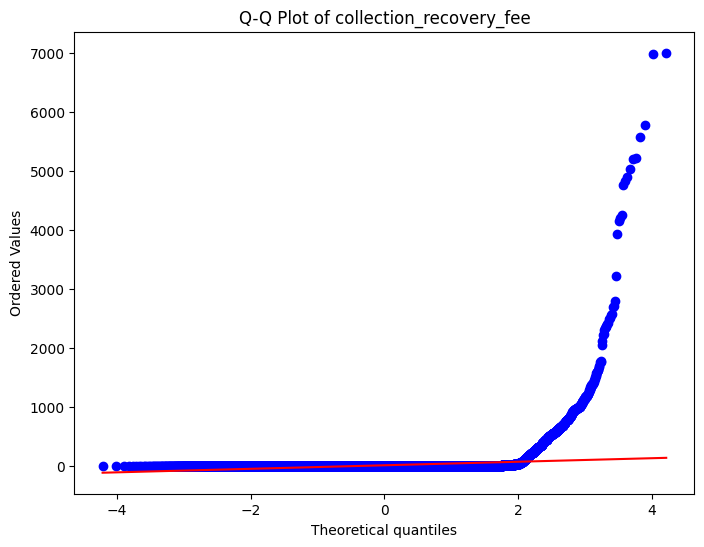

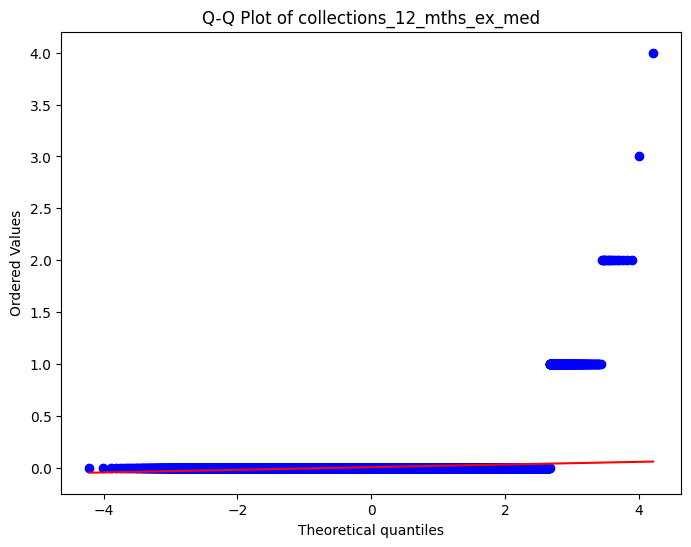

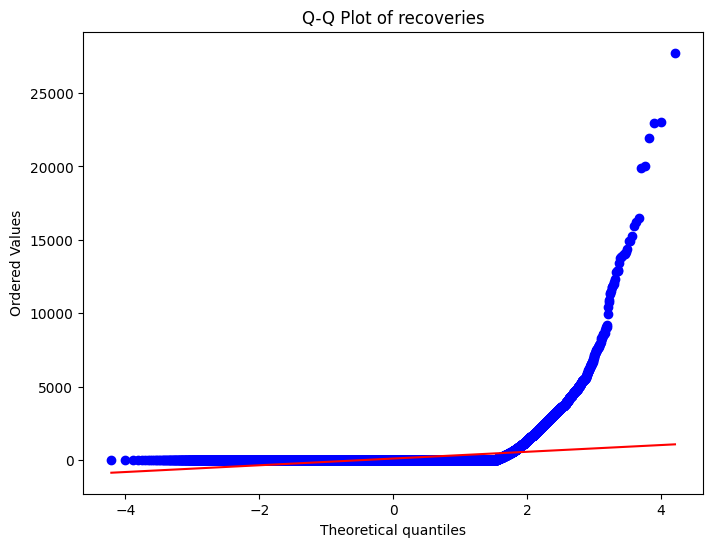

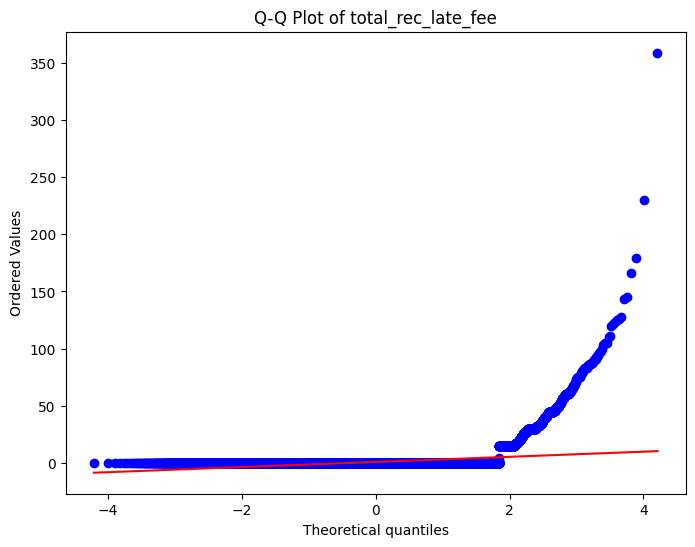

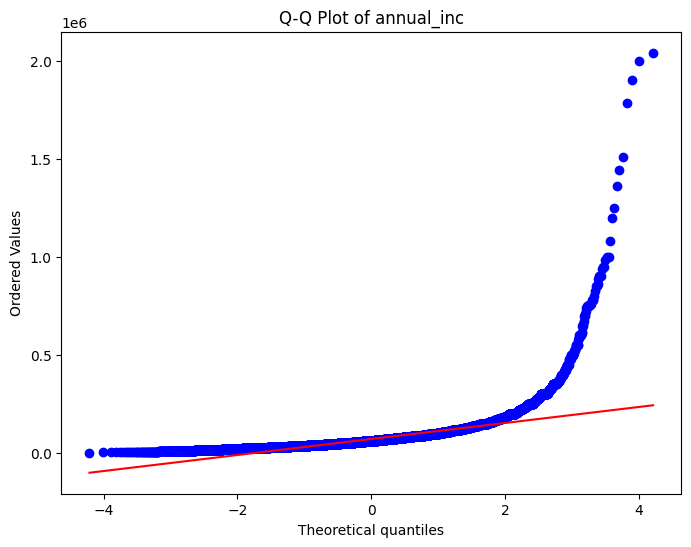

...

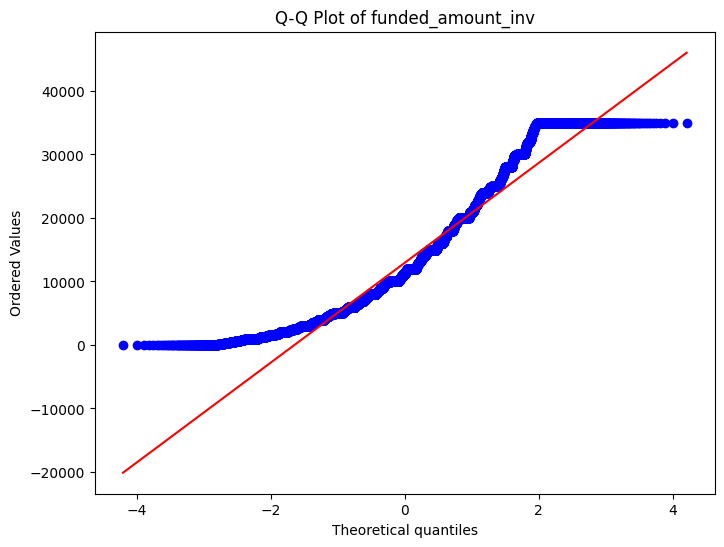

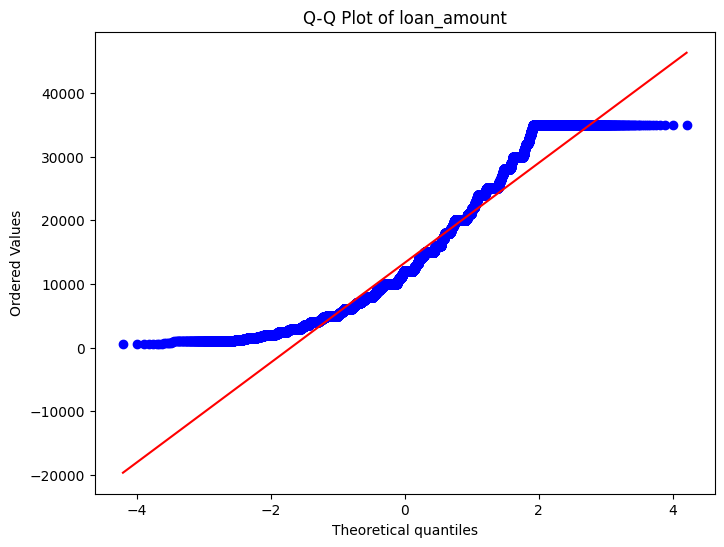

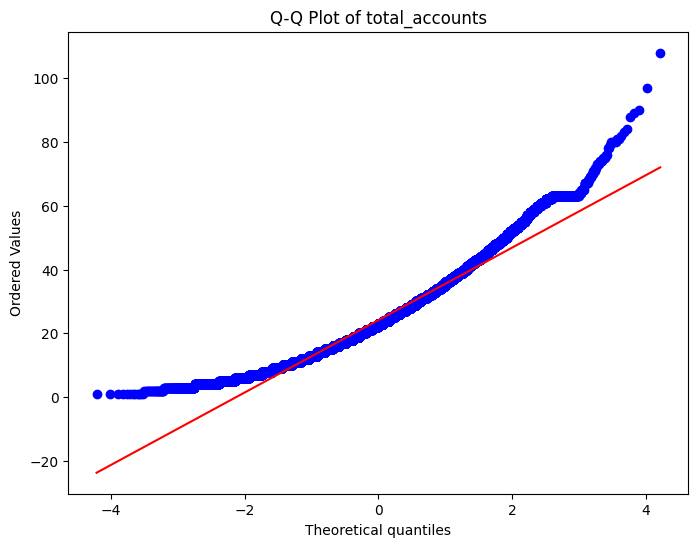

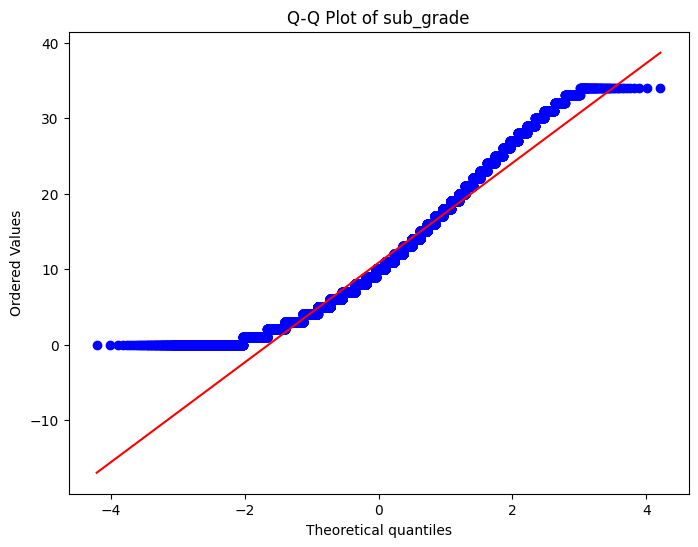

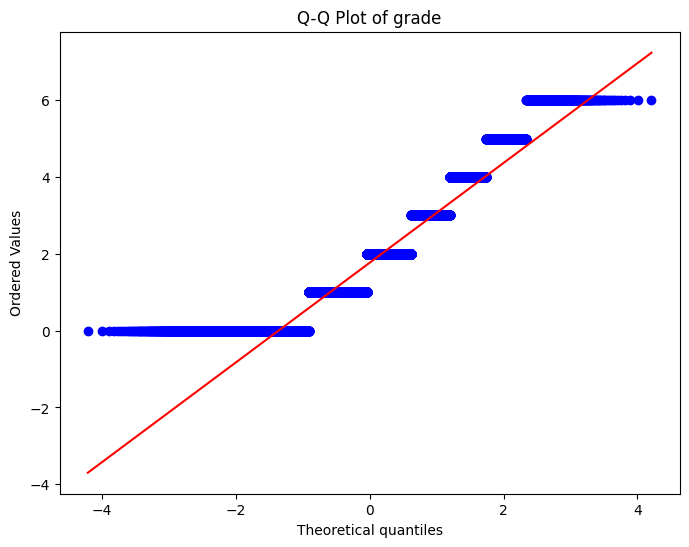

Histograms with KDE prior to Transformation:


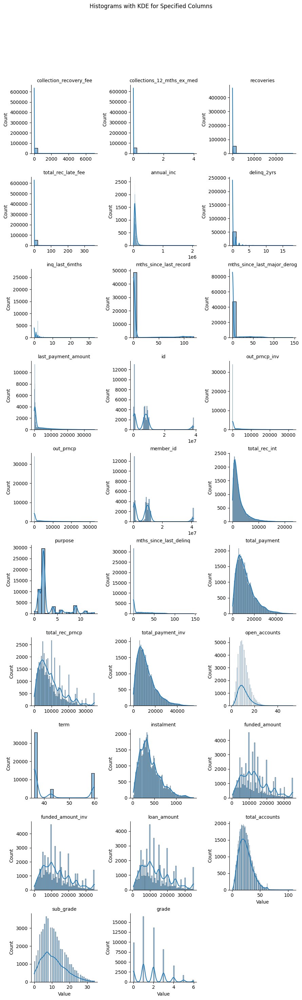

In [13]:
# Step 2: Visualize Q-Q Plots and Histograms Before Transformation
# Instantiate Plotter with the original DataFrame
plotter = Plotter(df)

# Q-Q Plots prior to Transformation
print("Q-Q Plots prior to Transformation:")
for col in skewed_columns:
    plotter.qq_plot(col)

# Histograms with KDE prior to Transformation using FacetGrid
print("Histograms with KDE prior to Transformation:")
plotter.plot_histograms_with_kde(skewed_columns)

### Print Skewness

In [14]:
print("\nSkewness Prior to Transformation (for all numeric columns):\n")
for col in skewed_columns:
    skewness_value = df[col].skew()
    print(f"{col}: {skewness_value:.4f}")


Skewness Prior to Transformation (for all numeric columns):

collection_recovery_fee: 27.6368
collections_12_mths_ex_med: 20.2624
recoveries: 14.5898
total_rec_late_fee: 13.1843
annual_inc: 8.7118
delinq_2yrs: 5.3700
inq_last_6mths: 3.2489
mths_since_last_record: 3.0254
mths_since_last_major_derog: 2.9561
last_payment_amount: 2.4994
id: 2.3703
out_prncp_inv: 2.3568
out_prncp: 2.3564
member_id: 2.2054
total_rec_int: 2.2043
purpose: 1.9010
mths_since_last_delinq: 1.4203
total_payment: 1.2679
total_rec_prncp: 1.2610
total_payment_inv: 1.2562
open_accounts: 1.0593
term: 1.0538
instalment: 0.9970
funded_amount: 0.8456
funded_amount_inv: 0.8139
loan_amount: 0.8053
total_accounts: 0.7790
sub_grade: 0.7002
grade: 0.6950


## Analysis of Skewness Prior to Transformation

Before applying transformations, an analysis of the skewness values for all numeric columns in the dataset revealed that many columns exhibited high levels of skewness, indicating non-normal distributions. Here are the main observations:

1. **Highly Skewed Columns**:<br> Several columns showed very high skewness values, such as `collection_recovery_fee` (27.6368), `collections_12_mths_ex_med` (20.2623), `recoveries` (14.5898), and `total_rec_late_fee` (6.2771). These high levels of skewness indicate the presence of extreme values or a large number of zeros, which is common in financial datasets where some features may have sparse but significant occurrences. Such skewness can adversely affect the performance of machine learning models, making it difficult for them to generalize well.
<br><br>
2. **Moderately Skewed Columns**:<br> Columns such as `delinq_2yrs` (5.3700), `inq_last_6mths` (3.2489), `last_payment_amount` (1.4370), and `out_prncp_inv` (1.2250) also exhibited moderate skewness. These columns could benefit from transformation to improve the symmetry of their distributions, potentially enhancing the model's ability to learn effectively from the data.
<br><br>
3. **Near-Normal Distributions**:<br> Some columns, such as `annual_inc` (0.1378), `funded_amount` (0.1529), `loan_amount` (0.1649), and `total_payment_inv` (0.2948), had skewness values close to zero. These columns are already approximately normally distributed and do not require significant transformation. However, minor adjustments could still improve their distributions slightly.
<br><br>
4. **Columns Requiring Special Consideration**:<br> Columns like `id` (2.3703), `member_id` (2.2054), and `term` (1.0538) had higher skewness, but their nature as identifiers or categorical-like values means that applying transformations may not always be appropriate. These columns may need to be treated differently, such as being excluded from transformations or encoded in a specific manner.
<br><br>
5. **Overall Observation**:<br> Many of the columns exhibited significant skewness before transformations, particularly features with high occurrences of zero values or a few extreme outliers. Addressing these issues through skewness-reducing transformations is crucial for improving the performance of machine learning models, especially when linear models or algorithms sensitive to non-normality are used.

### **Conclusion**
The analysis of skewness prior to transformation highlights the need for preprocessing steps to make the distributions more symmetric, reducing the impact of extreme outliers and improving model performance. Highly skewed columns, in particular, would benefit from transformations such as log or Box-Cox, while near-normal features could remain largely unchanged. Identifiers and categorical-like features should be carefully handled to avoid unnecessary transformations that could distort their meaning.

## **Step 11: Performing Transformations on skewed columns**



In [15]:
# Instantiate the updated class and apply transformations
transformer = DataFrameTransform(df)

# Continous data in pre-selected columns
columns_to_transform = [
    'loan_amount', 'funded_amount', 'funded_amount_inv', 'int_rate',
    'instalment', 'annual_inc', 'dti', 'out_prncp', 'out_prncp_inv',
    'total_payment', 'total_payment_inv', 'total_rec_int', 'total_rec_late_fee', 'last_payment_amount'
]

# Apply transformations to reduce skewness in the specified columns
transformer.transform_skewed_columns(columns_to_transform)

# Display the transformed DataFrame to verify transformations
df[columns_to_transform].head()


Original skewness for 'loan_amount': 0.81
Box-Cox transformation failed on 'loan_amount': name 'boxcox' is not defined
Yeo-Johnson transformation failed on 'loan_amount': name 'yeojohnson' is not defined
Applied sqrt transform on 'loan_amount' (new skewness: 0.16)

Original skewness for 'funded_amount': 0.85
Box-Cox transformation failed on 'funded_amount': name 'boxcox' is not defined
Yeo-Johnson transformation failed on 'funded_amount': name 'yeojohnson' is not defined
Applied sqrt transform on 'funded_amount' (new skewness: 0.15)

Original skewness for 'funded_amount_inv': 0.81
Yeo-Johnson transformation failed on 'funded_amount_inv': name 'yeojohnson' is not defined
Applied sqrt transform on 'funded_amount_inv' (new skewness: 0.07)

Original skewness for 'int_rate': 0.43
Box-Cox transformation failed on 'int_rate': name 'boxcox' is not defined
Yeo-Johnson transformation failed on 'int_rate': name 'yeojohnson' is not defined
Applied sqrt transform on 'int_rate' (new skewness: 0.01)

,loan_amount,funded_amount,funded_amount_inv,int_rate,instalment,annual_inc,dti,out_prncp,out_prncp_inv,total_payment,total_payment_inv,total_rec_int,total_rec_late_fee,last_payment_amount
0,89.442719,89.442719,89.442719,2.736786,15.774029,10.736418,4.420407,74.361953,74.361953,54.612361,54.612361,22.632057,0.0,15.774029
1,114.891253,114.891253,114.891253,2.643861,20.187125,10.819798,4.919350,95.408752,95.408752,69.893562,69.893562,28.070269,0.0,20.187125
2,126.491106,126.491106,126.491106,2.736786,22.307622,11.210658,4.113393,0.000000,0.000000,129.709445,129.709445,28.714805,0.0,113.358546
3,122.474487,122.474487,122.474487,3.782856,22.692069,10.645449,5.959866,0.000000,0.000000,126.283293,126.283293,30.781001,0.0,117.896862
4,122.474487,122.474487,122.474487,2.455606,21.366797,11.884496,1.824829,101.476450,101.476450,73.982836,73.982836,27.765626,0.0,21.366797


In [16]:
# After transformation, ensure the transformed DataFrame is used in the Plotter
transformed_df = transformer.df

Q-Q Plots after Transformation:


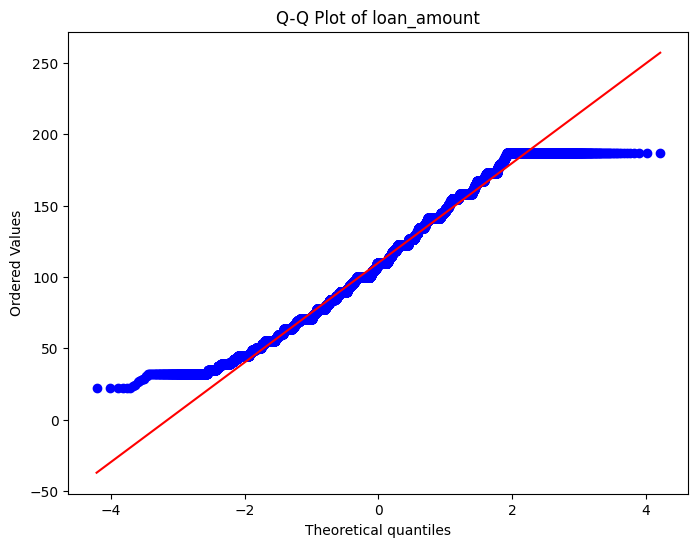

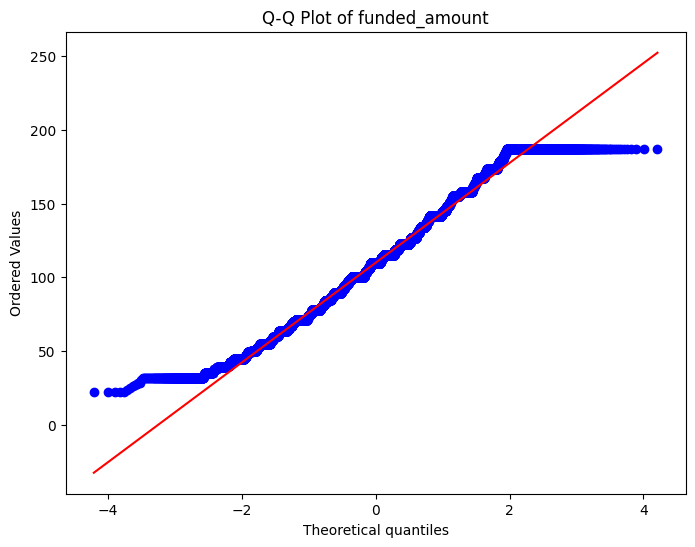

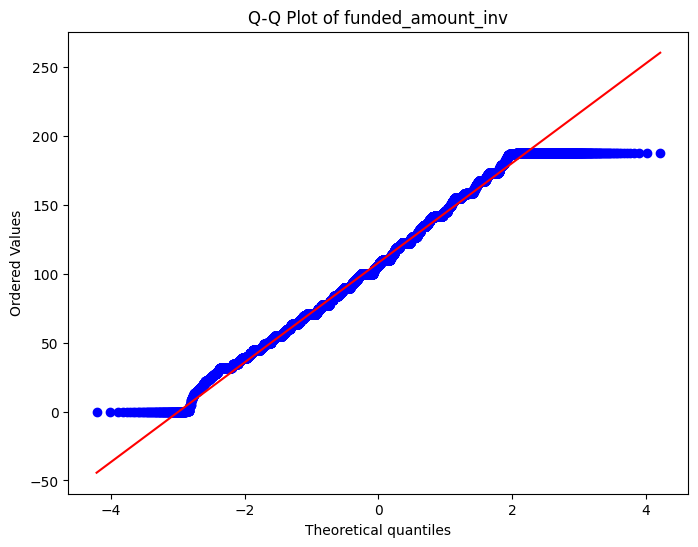

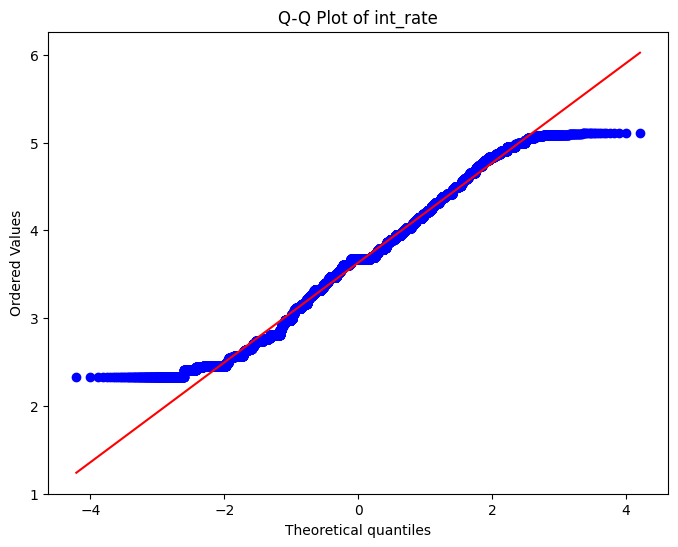

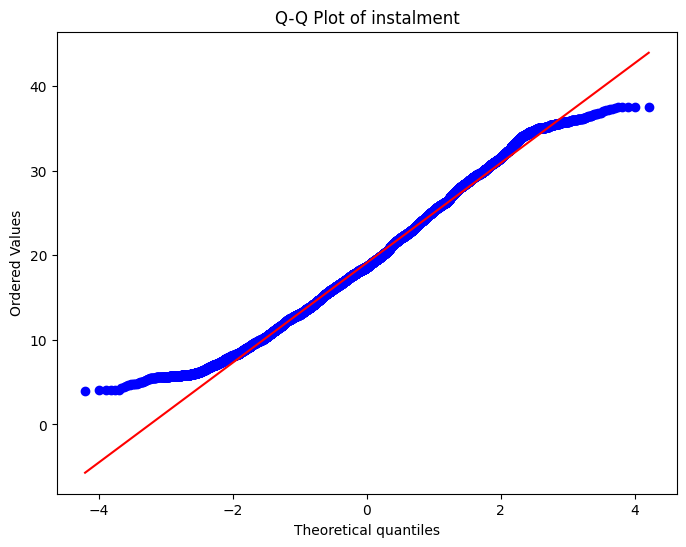

...

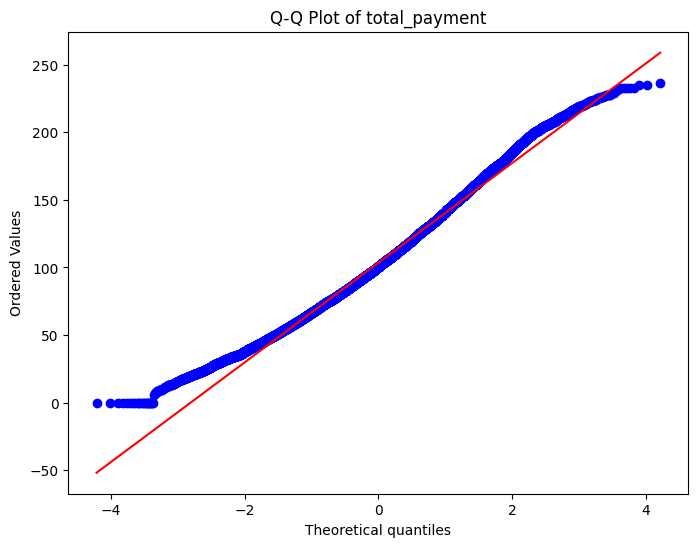

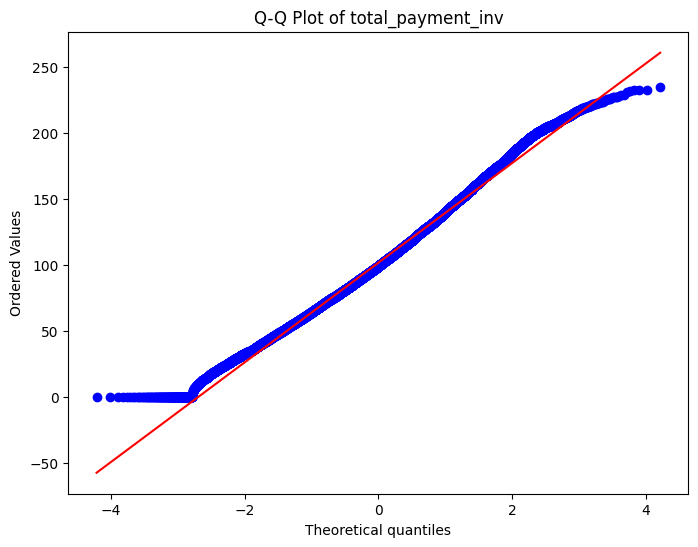

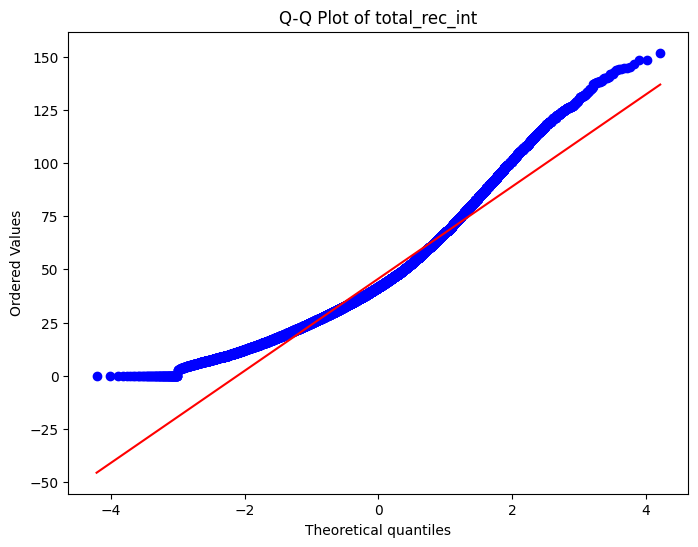

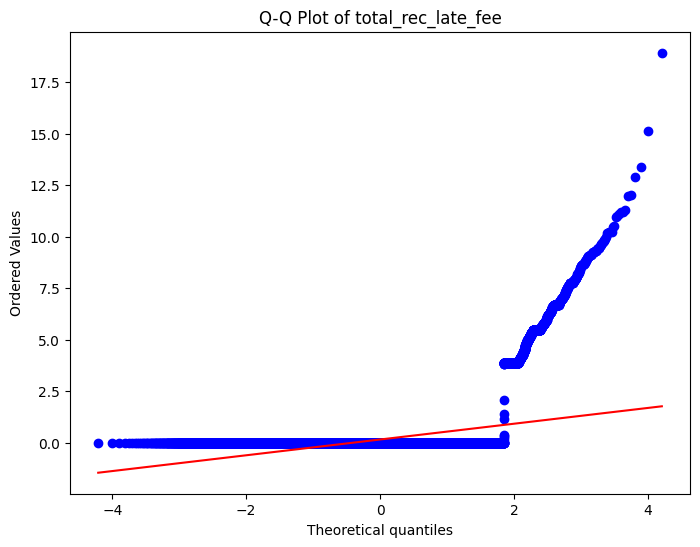

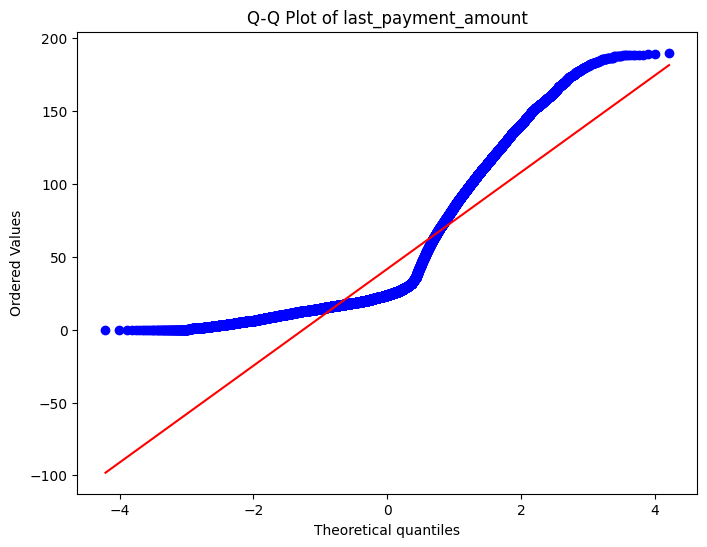

Histograms with KDE after Transformation:


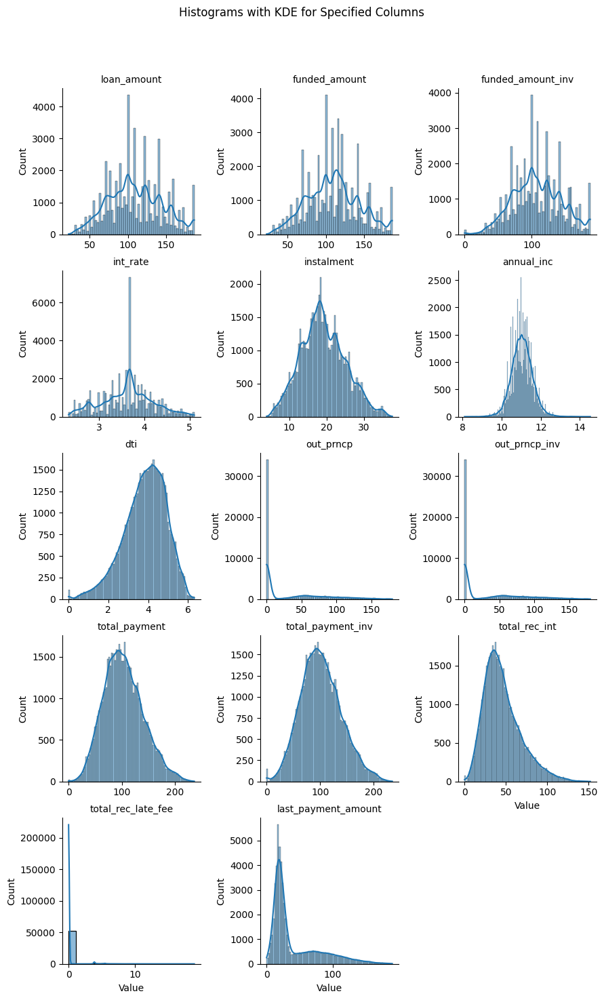

In [17]:
# Instantiate Plotter with the transformed DataFrame
plotter = Plotter(transformed_df)

# Q-Q Plots after Transformation
print("Q-Q Plots after Transformation:")
for col in columns_to_transform:
    plotter.qq_plot(col)

# Histograms with KDE after Transformation using FacetGrid
print("Histograms with KDE after Transformation:")
plotter.plot_histograms_with_kde(columns_to_transform)

In [18]:
# Step 5: Print Skewness After Transformation for All Columns (only for numeric columns)
print("\nSkewness After Transformation (for all numeric columns):\n")
skewness_after = {}
for col in transformer.df.columns:
    if pd.api.types.is_numeric_dtype(transformer.df[col]):
        skewness_value = transformer.df[col].skew()
        skewness_after[col] = skewness_value
        print(f"{col}: {skewness_value:.4f}")
    else:
        print(f"{col}: Skewness not applicable (non-numeric column)")


Skewness After Transformation (for all numeric columns):

id: 2.3703
member_id: 2.2054
loan_amount: 0.1649
funded_amount: 0.1529
funded_amount_inv: 0.0723
term: 1.0538
int_rate: 0.0143
instalment: 0.2459
grade: 0.6950
sub_grade: 0.7002
employment_length: 0.4335
home_ownership: 0.0392
annual_inc: 0.1378
verification_status: -0.1120
issue_date: Skewness not applicable (non-numeric column)
loan_status: -0.1006
payment_plan: Skewness not applicable (non-numeric column)
purpose: 1.9010
dti: -0.5747
delinq_2yrs: 5.3700
earliest_credit_line: Skewness not applicable (non-numeric column)
inq_last_6mths: 3.2489
mths_since_last_delinq: 1.4203
mths_since_last_record: 3.0254
open_accounts: 1.0593
total_accounts: 0.7790
out_prncp: 1.2246
out_prncp_inv: 1.2250
total_payment: 0.3739
total_payment_inv: 0.2948
total_rec_prncp: 1.2610
total_rec_int: 0.9184
total_rec_late_fee: 6.2771
recoveries: 14.5898
collection_recovery_fee: 27.6368
last_payment_date: Skewness not applicable (non-numeric column)
last_

## Analysis of Skewness After Transformation

After applying transformations to reduce skewness, we can analyze the skewness values for all numeric columns in the dataset. The results indicate significant improvements in the skewness for many columns, though some remain skewed. Here are the main observations:

1. **Successful Reduction of Skewness**:<br>Several key columns, such as `loan_amount`, `funded_amount`, `funded_amount_inv`, `int_rate`, and `annual_inc`, now have skewness values closer to zero (e.g., `loan_amount`: 0.1649, `funded_amount`: 0.1529). This suggests that the applied transformations effectively made these distributions more symmetric, which is beneficial for improving model performance and ensuring better statistical properties.
<br><br>
2. **Moderate Skewness Remains**:<br> Some columns, such as `term` (1.0538), `out_prncp` (1.2246), and `last_payment_amount` (1.4370), still show moderate skewness. Although transformations have helped to reduce their skewness, these columns may still require additional techniques (e.g., further transformations or binning) if achieving near-normality is critical.
<br><br>
3. **Highly Skewed Columns**:<br> Certain columns remain highly skewed even after transformations. These include `delinq_2yrs` (5.3700), `total_rec_late_fee` (6.2771), `recoveries` (14.5898), `collection_recovery_fee` (27.6368), and `collections_12_mths_ex_med` (20.2623). These high levels of skewness suggest that the data contains many zero or extreme values, which may require special handling, such as applying more robust transformations or considering feature engineering techniques that better represent these features.
<br><br>
4. **Categorical Columns**:<br> Columns such as `grade`, `sub_grade`, `employment_length`, `home_ownership`, etc., are non-numeric and thus do not have skewness values calculated. These columns should be encoded appropriately (e.g., using one-hot encoding or ordinal encoding) before they can be used in modeling.
<br><br>
5. **Stable Columns**:<br> Some columns, such as `policy_code` (0.0000), showed no skewness, which indicates a uniform or constant distribution. Such features may require careful consideration as they could be less informative for a predictive model.

### **Conclusion**
The skewness analysis after transformation shows that the applied techniques were generally effective in reducing skewness for many numeric features, making them more suitable for machine learning models. However, certain features remain highly skewed, which indicates a need for additional transformation or domain-specific feature engineering to better address these distributions. The non-numeric features require proper encoding before they can be used effectively in modeling.



In [19]:
# Save a cleaned copy of the DataFrame for further analysis
df.to_csv("b_df_4_tranformed_loan_data.csv", index=False)
print("The transformed DataFrame has been saved as 'b_df_4_transformed_loan_data.csv'")

The transformed DataFrame has been saved as 'b_df_4_transformed_loan_data.csv'
